THIS NOTEBOOK WAS MODIFIED FOR THE SOCIAL NAVIGATION TASK

In this notebook, we are goin to compute wavelet time-frequency spectrograms for events, baselined to other epochs (e.g. fixation crosses) from the task. We are also going to focus on saving the data out in an efficient matter for subsequent analysis

## Loading libraries

In [1]:
%matplotlib inline
%reload_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import mne
from glob import glob
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import seaborn as sns
import pandas as pd
import os 
import joblib
import pickle
from tqdm import tqdm
from IPython.display import clear_output
import warnings 
from ast import literal_eval


# I only want to see warnings once
warnings.filterwarnings('ignore')

from joblib import delayed, Parallel
from statsmodels.stats import multitest

Note: Different users can have different paths. When sharing code with others, you can define username and use it instead of hardcoding paths.

In [3]:
import getpass
username = getpass.getuser()
print(username)

jainp08


In [4]:
# # Set some plot defaults for matplotlib (when not using seaborn): 

# import  matplotlib.font_manager

# plot_path = '/sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/Plots/TFR'
# if not os.path.exists(plot_path):
#     os.mkdir(plot_path)
# matplotlib.font_manager.fontManager.addfont(plot_path)

# prop = matplotlib.font_manager.FontProperties(fname=plot_path)

# # Set the default font family to the registered custom font
# plt.rcParams['font.family'] = prop.get_name()

# # Rest of your customization code
# plt.rcParams['font.size'] = 20
# plt.rcParams['lines.linewidth'] = 1

Note: If you have installed this package in editable form on Minerva, you must append the local path! This is because Minerva requires that you point your package installs away from the local directory for space reasons, but editable packages have to be installed locally.

Note: If you have installed the LFPAnalysis package in editable form on Minerva, you must append the local path! This is because Minerva requires that you point your package installs away from the local directory for space reasons, but editable packages have to be installed locally.

THE VERSION USED HERE CAN BE FOUND AT https://github.com/gelanat/LFPAnalysis.git

In [5]:
import sys
sys.path.append(f'/hpc/users/{username}/LFPAnalysis/')
if username=='jainp08':
    sys.path.append(f'/hpc/users/{username}/LFPAnalysis_SNT/')

In [6]:
from LFPAnalysis_SNT import lfp_preprocess_utils, sync_utils, analysis_utils, nlx_utils, oscillation_utils, statistics_utils

## Setting variables

In [7]:
subj_ids = ['MS019']
# ['MS008', 'MS009', 'MS019', 'MS020', 'MS030',
#             'MS034', 'MS042', 'MS043', 'MS045', 'MS047', 
#             'MS048', 'MS050', 'MS051', 'MS052', 'MS053',
#             'MS054']
subj_sites = ['MSSM' for _ in subj_ids]
subj_formats = ['edf' for _ in subj_ids]

if username == 'tostag01':
    base_dir = '/sc/arion/projects/OlfMem/tostag01/SocialNav'

if username == 'jainp08':
    base_dir = '/sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG'

## Wavelet TFRs

In order to compute event-locked time-frequency spectrograms, we need to first compute them for the baseline of interest (usually a fixation cross) and then for the events of interest (usually a patient choice epoch). 



In [9]:
# Explicitly define a list of analysis events and the baseline event. Should correspond to the dict

# baseline_event = {'baseline_start':[0, 0.75]}
# task_events = {'feedback_start': [0, 1.5]}

baseline_event = {'baseline': [-0.5, 0]}  # baseline, few ms before options slide
task_events = {'decision_time': [-1.5, 0], #ChoiceOnset
               'narration_slide': [-1.5, 0], # narration slide
               'ITI': [0, 0.5],  # ITI
              }
# task_events = {'ITI': [0, 0.5]}

# Define parameters for TFR (this is what I default to): 
freqs = np.logspace(*np.log10([2, 200]), num=30)
n_cycles = np.floor(np.logspace(*np.log10([3, 10]), num=30))

In [10]:
# run baselining

for subj_id in tqdm(subj_ids):
    lfp_preprocess_utils.compute_and_baseline_tfr(baseline_event, task_events, freqs, n_cycles, 
                             load_path=f'{base_dir}/preproc/{subj_id}/LFP/',
                             save_path=f'{base_dir}/preproc/{subj_id}/LFP/',
                             IED_artifact_thresh=True, uncaptured_z_thresh=True, output='save')

  0%|          | 0/1 [00:00<?, ?it/s]

Reading /sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/preproc/MS019/LFP/baseline-epo.fif ...
    Found the data of interest:
        t =   -1500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
63 matching events found
No baseline correction applied
0 projection items activated
NOTE: tfr_morlet() is a legacy function. New code should use .compute_tfr(method="morlet").


[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    1.4s


Reading /sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/preproc/MS019/LFP/decision_time-epo.fif ...
    Found the data of interest:
        t =   -2500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Adding metadata with 24 columns
38 matching events found
No baseline correction applied
0 projection items activated
NOTE: tfr_morlet() is a legacy function. New code should use .compute_tfr(method="morlet").


[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    1.0s


baseline z-score iteration # 0
baseline z-score iteration # 1
Adding metadata with 24 columns
Overwriting existing file.
Reading /sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/preproc/MS019/LFP/narration_slide-epo.fif ...
    Found the data of interest:
        t =   -2500.00 ...    1000.00 ms
        0 CTF compensation matrices available
Not setting metadata
132 matching events found
No baseline correction applied
0 projection items activated
NOTE: tfr_morlet() is a legacy function. New code should use .compute_tfr(method="morlet").


[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    3.4s


baseline z-score iteration # 0
baseline z-score iteration # 1
Not setting metadata
Overwriting existing file.
Reading /sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/preproc/MS019/LFP/ITI-epo.fif ...
    Found the data of interest:
        t =   -1000.00 ...    1500.00 ms
        0 CTF compensation matrices available
Adding metadata with 24 columns
38 matching events found
No baseline correction applied
0 projection items activated
NOTE: tfr_morlet() is a legacy function. New code should use .compute_tfr(method="morlet").


[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:    0.8s


baseline z-score iteration # 0
baseline z-score iteration # 1
Adding metadata with 24 columns
Overwriting existing file.


100%|██████████| 1/1 [00:49<00:00, 49.86s/it]


In [11]:
rois = ['HPC']#, 'AMY', 'ACC', 'PCC', 'OFC']

In [58]:
# Let's load the power epochs for specific conditions: 

analysis_evs = ['decision_time']

conditions = ['affil', 'power']

# task condition to contrast 

tfr_group_data = {f'{a}': {f'{b}': [] for b in conditions} for a in rois}

for event in analysis_evs:
    load_path = f'{base_dir}/preproc/{subj_id}/LFP/'
    
    power_epochs = mne.time_frequency.read_tfrs(f'{load_path}/{event}-tfr.h5')

    condition_indices = {'affil': list(np.where(power_epochs.metadata.dimension == 'affil')[0]),
                     'power': list(np.where(power_epochs.metadata.dimension == 'power')[0])}
    
    # power_epochs.metadata = behav_df

    # Get electrode df 
    elec_df = pd.read_csv(f'{load_path}/labels_bp')

    progress_bar = tqdm(elec_df.label, ascii=True, desc='Aggregating TFRs')

    for elec_ix, chan in enumerate(progress_bar):
        region = elec_df.SNT_region.iloc[elec_ix]
        if region in rois:
            for ix, cond in enumerate(conditions):
                # Set the times for 
                # times = power_epochs.times
                
                # plot_data = np.nanmean(np.squeeze(power_epochs.copy().pick([chan]).data[condition_indices[cond]]), axis=0)
                data = np.squeeze(power_epochs.copy().pick([chan]).data[condition_indices[cond]])
                n_epochs = data.shape[0]
                good_epochs = []
                for epoch in range(n_epochs):
                    if np.any(np.isnan(data[epoch])):
                        continue
                    good_epochs.append(epoch)
                plot_data = np.nanmean(data[good_epochs, :, :], axis=0)

                tfr_group_data[region][cond].append(plot_data)                    
                    

Reading /sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/preproc/MS019/LFP/decision_time-tfr.h5 ...
Replacing existing metadata with 24 columns


Aggregating TFRs: 100%|##########| 66/66 [00:01<00:00, 47.55it/s]


If computing the SME, don't mean before the statistical contrast.... but do so before visualizing the TFR...? 

## Region-wise TFR

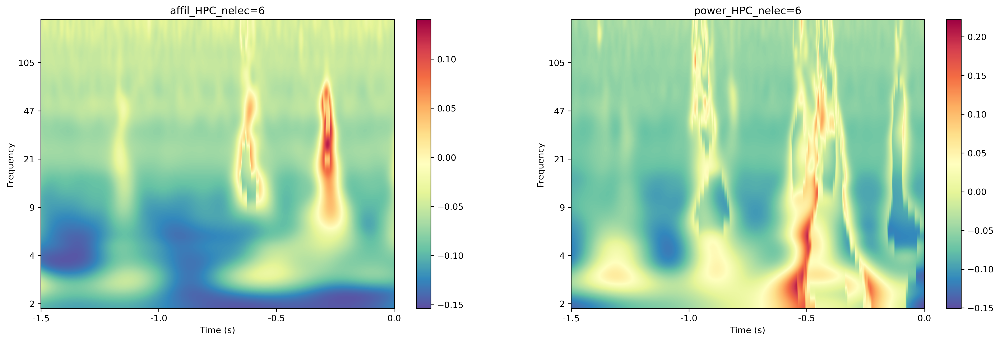

In [57]:
freqs = np.logspace(*np.log10([2, 200]), num=30)

for region in rois: 
    # if region == 'TC':
    #     region = (('Temporal') | ('Temporal Pole') | ('STS'))
    fig, ax = plt.subplots(1, 2, figsize=(20, 6), dpi=300)
    for ix, cond in enumerate(conditions): 
        # Set the times for 
        if tfr_group_data[region][cond] == []:
            continue
        n_elecs = np.squeeze(np.stack(tfr_group_data[region][cond])).shape[0]
        times = np.linspace(-1.5, 0, np.squeeze(np.stack(tfr_group_data[region][cond])).shape[2])

        plot_data = np.nanmean(np.squeeze(np.stack(tfr_group_data[region][cond])), axis=0)
        im = ax[ix].imshow(plot_data,
                          aspect='auto', origin='lower', cmap='Spectral_r', interpolation = 'bicubic')            
        ax[ix].set(xlabel='Time (s)', ylabel='Frequency', title=f'{cond}_{region}_nelec={n_elecs}')

        # Set custom y-axis ticks and labels
        freq_res = 5
        time_res = 250 
        ax[ix].set(yticks=np.arange(0, len(freqs))[::freq_res], 
               yticklabels=freqs[::freq_res].astype(int), 
               xticks = np.arange(len(times))[::time_res],
               xticklabels= times[::time_res])#zpow.times[::time_res])

        fig.colorbar(im, ax=ax[ix])
        # plt.savefig(f'/sc/arion/work/qasims01/MemoryBanditData/EMU/plots/feedback_TFR_{cond_name}_{region}.pdf', dpi=300)
        

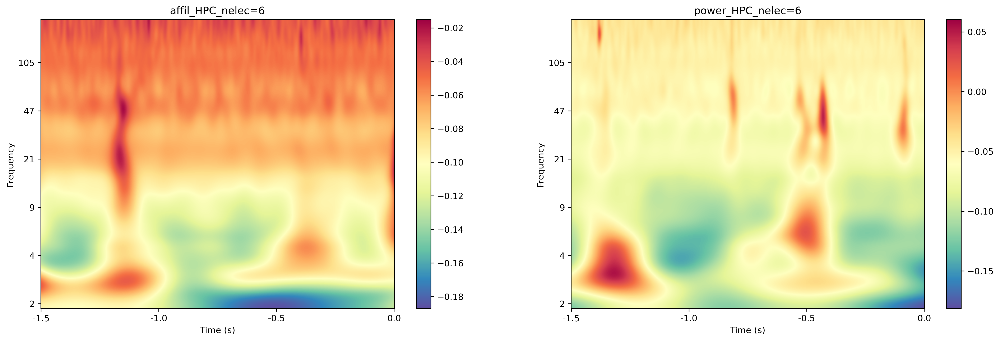

In [59]:
freqs = np.logspace(*np.log10([2, 200]), num=30)

for region in rois: 
    # if region == 'TC':
    #     region = (('Temporal') | ('Temporal Pole') | ('STS'))
    fig, ax = plt.subplots(1, 2, figsize=(20, 6), dpi=300)
    for ix, cond in enumerate(conditions): 
        # Set the times for 
        if tfr_group_data[region][cond] == []:
            continue
        n_elecs = np.squeeze(np.stack(tfr_group_data[region][cond])).shape[0]
        times = np.linspace(-1.5, 0, np.squeeze(np.stack(tfr_group_data[region][cond])).shape[2])

        plot_data = np.nanmean(np.squeeze(np.stack(tfr_group_data[region][cond])), axis=0)
        im = ax[ix].imshow(plot_data,
                          aspect='auto', origin='lower', cmap='Spectral_r', interpolation = 'bicubic')            
        ax[ix].set(xlabel='Time (s)', ylabel='Frequency', title=f'{cond}_{region}_nelec={n_elecs}')

        # Set custom y-axis ticks and labels
        freq_res = 5
        time_res = 250 
        ax[ix].set(yticks=np.arange(0, len(freqs))[::freq_res], 
               yticklabels=freqs[::freq_res].astype(int), 
               xticks = np.arange(len(times))[::time_res],
               xticklabels= times[::time_res])#zpow.times[::time_res])

        fig.colorbar(im, ax=ax[ix])
        # plt.savefig(f'/sc/arion/work/qasims01/MemoryBanditData/EMU/plots/feedback_TFR_{cond_name}_{region}.pdf', dpi=300)
        

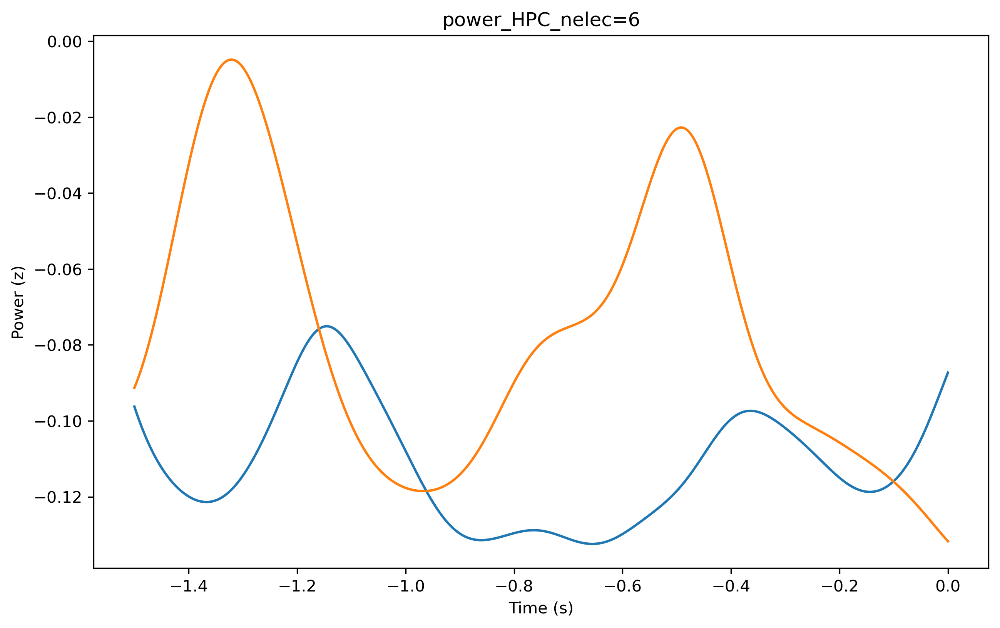

In [60]:
for region in rois: 
    # if region == 'TC':
    #     region = (('Temporal') | ('Temporal Pole') | ('STS'))
    fig, ax = plt.subplots(1, 1, figsize=(10, 6), dpi=300, sharey=True, sharex=True)
    for ix, cond in enumerate(conditions): 
        # Set the times for 
        n_elecs = np.squeeze(np.stack(tfr_group_data[region][cond])).shape[0]
        times = np.linspace(-1.5, 0, np.squeeze(np.stack(tfr_group_data[region][cond])).shape[2])

#         if cond_name == 'SME':
#             plot_data = np.nanmedian(np.nanmedian(np.squeeze(np.stack(tfr_group_data[region][cond])), axis=0), axis=0)
#         else:
        plot_data = np.nanmean(np.squeeze(np.stack(tfr_group_data[region][cond])), axis=0)
        ax.plot(times, np.nanmean(plot_data[freqs<9, :], axis=0))
      
        ax.set(xlabel='Time (s)', ylabel='Power (z)', title=f'{cond}_{region}_nelec={n_elecs}')
        # fig.colorbar(im, ax=ax[ix])
        # plt.savefig(f'/sc/arion/work/qasims01/MemoryBanditData/EMU/plots/feedback_theta_{cond_name}_{region}.pdf', dpi=300)


## Per-electrode TFR

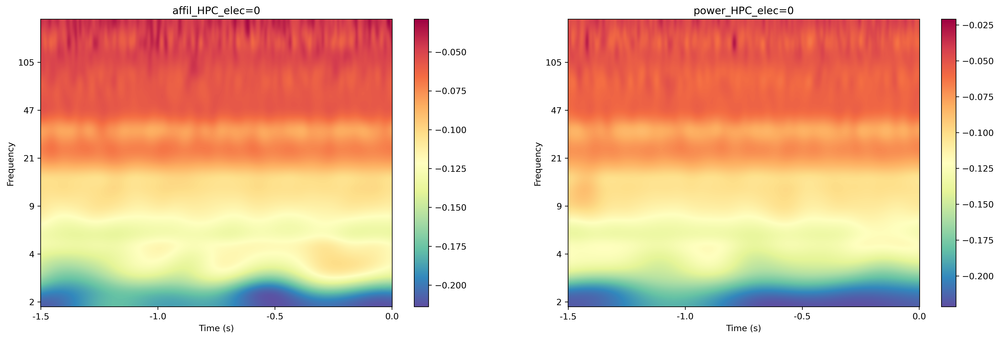

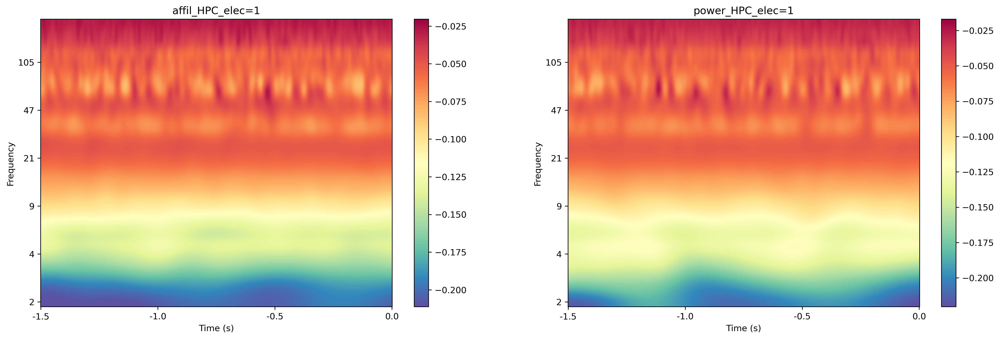

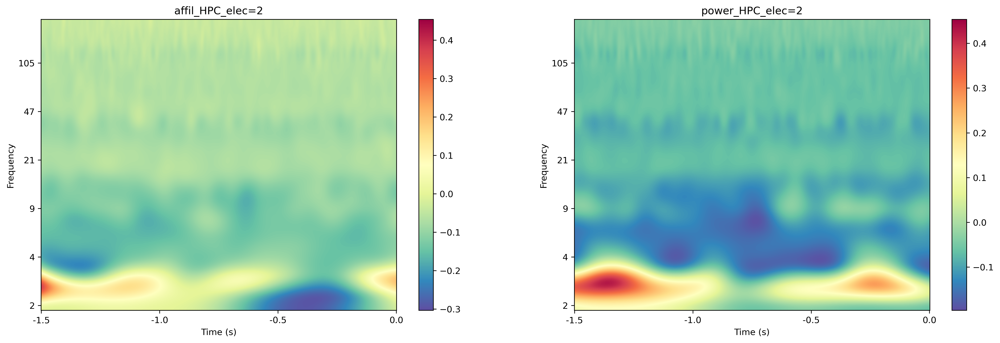

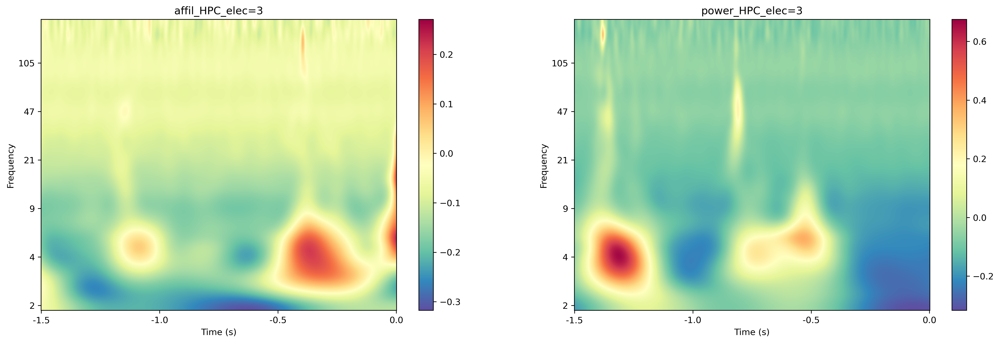

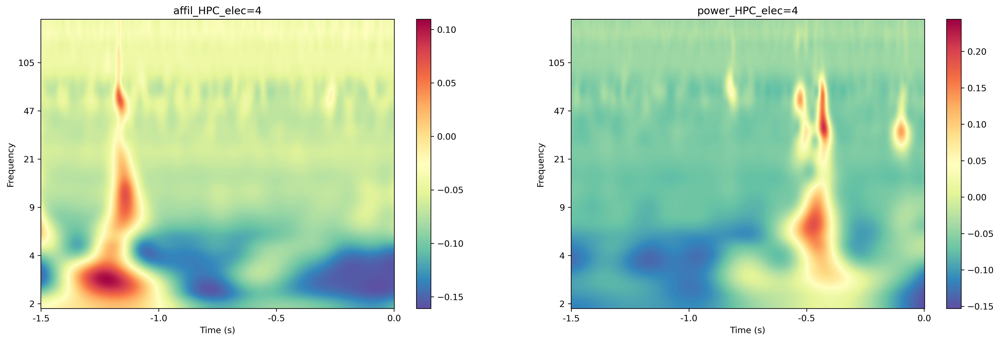

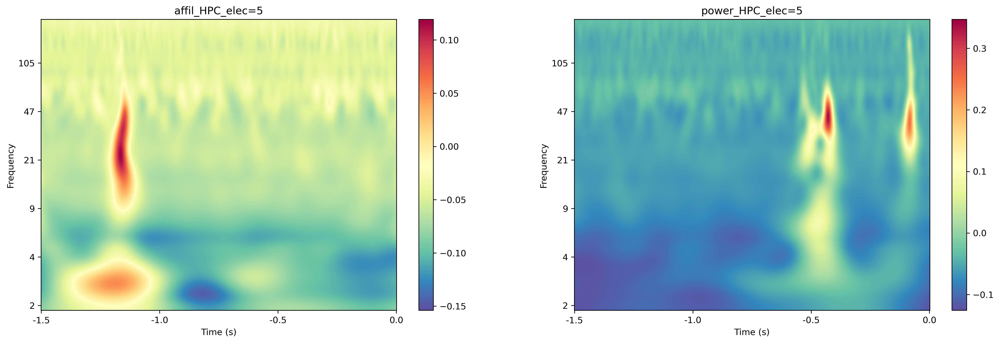

In [61]:
freqs = np.logspace(*np.log10([2, 200]), num=30)

for region in rois: 
    # if region == 'TC':
    #     region = (('Temporal') | ('Temporal Pole') | ('STS'))
    n_elecs = np.squeeze(np.stack(tfr_group_data[region][conditions[0]])).shape[0]
    for ch in range(n_elecs):
        fig, ax = plt.subplots(1, 2, figsize=(20, 6), dpi=300)
        for ix, cond in enumerate(conditions): 
            # Set the times for 
            if tfr_group_data[region][cond] == []:
                continue
            n_elecs = np.squeeze(np.stack(tfr_group_data[region][cond])).shape[0]
            times = np.linspace(-1.5, 0, np.squeeze(np.stack(tfr_group_data[region][cond])).shape[2])
            plot_data = np.squeeze(np.stack(tfr_group_data[region][cond]))

            im = ax[ix].imshow(plot_data[ch, :, :],
                              aspect='auto', origin='lower', cmap='Spectral_r', interpolation = 'bicubic')            
            ax[ix].set(xlabel='Time (s)', ylabel='Frequency', title=f'{cond}_{region}_elec={ch}')
        
            # Set custom y-axis ticks and labels
            freq_res = 5
            time_res = 250 
            ax[ix].set(yticks=np.arange(0, len(freqs))[::freq_res], 
                   yticklabels=freqs[::freq_res].astype(int), 
                   xticks = np.arange(len(times))[::time_res],
                   xticklabels= times[::time_res])#zpow.times[::time_res])
        
            fig.colorbar(im, ax=ax[ix])
            
        # plt.savefig(f'/sc/arion/work/qasims01/MemoryBanditData/EMU/plots/feedback_TFR_{cond_name}_{region}.pdf', dpi=300)
        

## Epoch-specific TFR

In [68]:
# Let's load the power epochs for specific conditions: 

analysis_evs = ['decision_time']

# task condition to contrast 

condition_indices = {'affil': list(np.where(power_epochs.metadata.dimension == 'affil')[0]),
                     'power': list(np.where(power_epochs.metadata.dimension == 'power')[0])}
conditions = list(condition_indices.keys())

tfr_epoch_data = {f'{a}': {f'{b}': [] for b in condition_indices} for a in rois}

for event in analysis_evs:
    load_path = f'{base_dir}/preproc/{subj_id}/LFP/'
    
    power_epochs = mne.time_frequency.read_tfrs(f'{load_path}/{event}-tfr.h5')

    # power_epochs.metadata = behav_df

    # Get electrode df 
    elec_df = pd.read_csv(f'{load_path}/labels_bp')

    progress_bar = tqdm(elec_df.label, ascii=True, desc='Aggregating TFRs')

    for elec_ix, chan in enumerate(progress_bar):
        region = elec_df.SNT_region.iloc[elec_ix]
        if region in rois:
            for ix, cond in enumerate(conditions):
                # Set the times for 
                # times = power_epochs.times
                # plot_data = np.squeeze(power_epochs.copy().pick([chan]).data[condition_indices[cond]])
                data = np.squeeze(power_epochs.copy().pick([chan]).data[condition_indices[cond]])
                n_epochs = data.shape[0]
                good_epochs = []
                for epoch in range(n_epochs):
                    if np.any(np.isnan(data[epoch])):
                        continue
                    good_epochs.append(epoch)
                plot_data = data[good_epochs, :, :]
                tfr_epoch_data[region][cond].append(plot_data)
                    

Reading /sc/arion/projects/OlfMem/jainp08/Social_Navigation/SEEG/preproc/MS019/LFP/decision_time-tfr.h5 ...
Replacing existing metadata with 24 columns


Aggregating TFRs: 100%|##########| 66/66 [00:01<00:00, 51.18it/s]


In [76]:
tfr_epoch_data['HPC']['affil'][0].shape

(15, 30, 751)

In [75]:
np.squeeze(np.stack(tfr_epoch_data['HPC']['affil'][0])).shape[0]

15

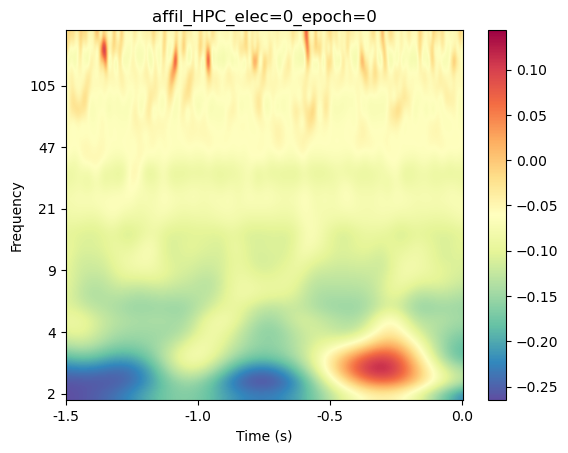

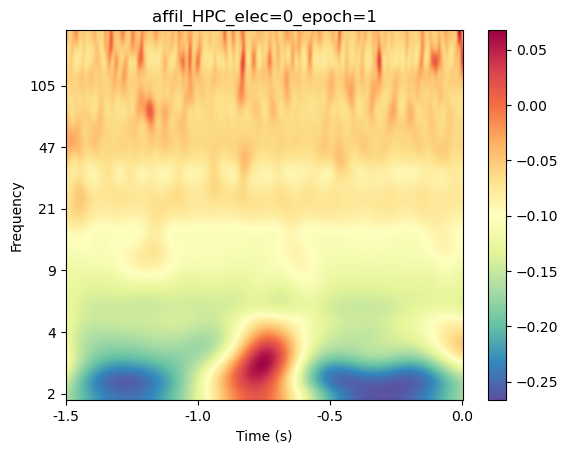

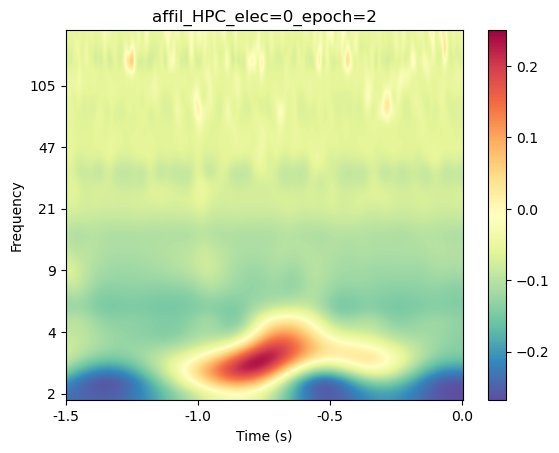

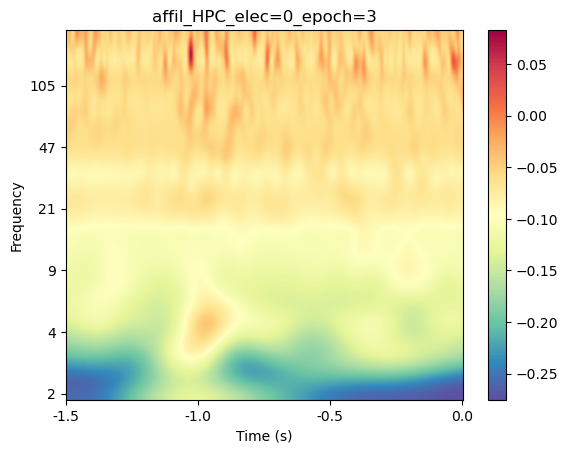

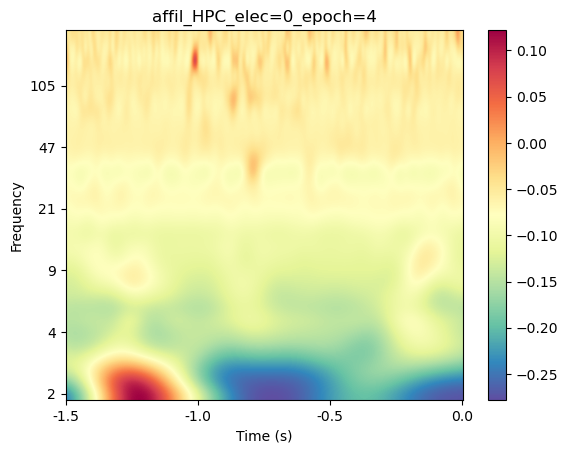

...

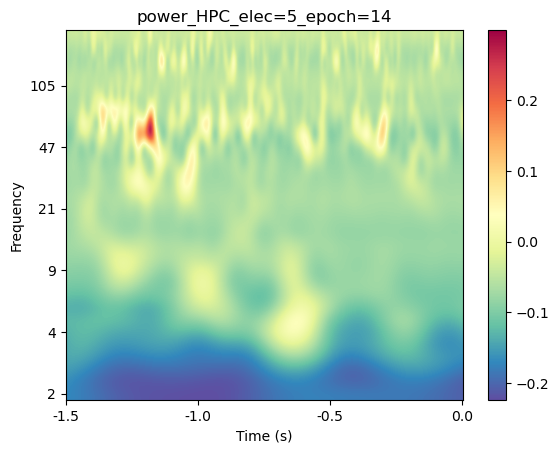

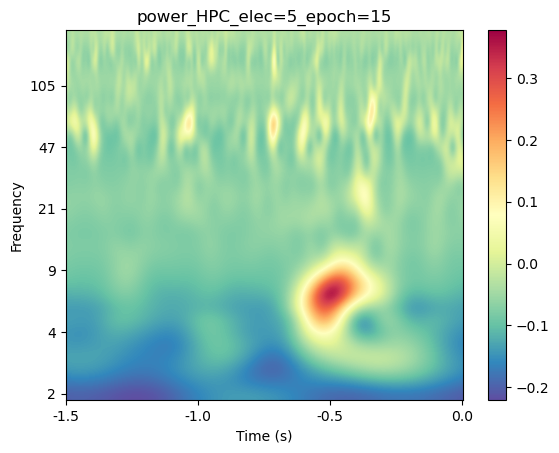

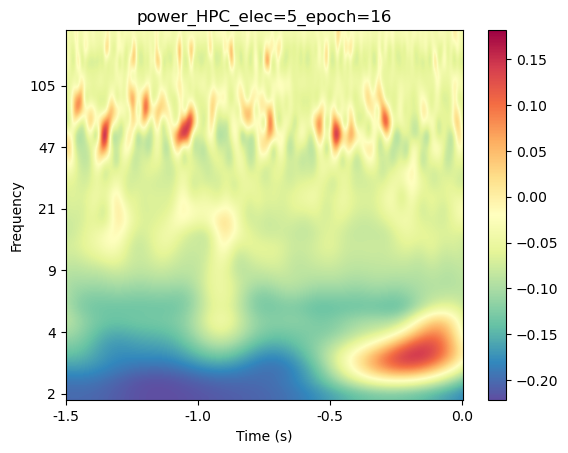

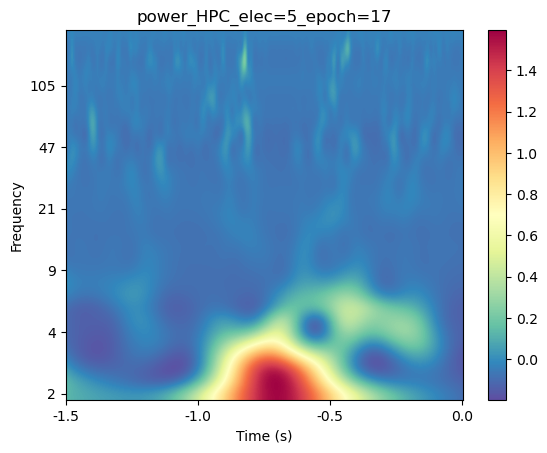

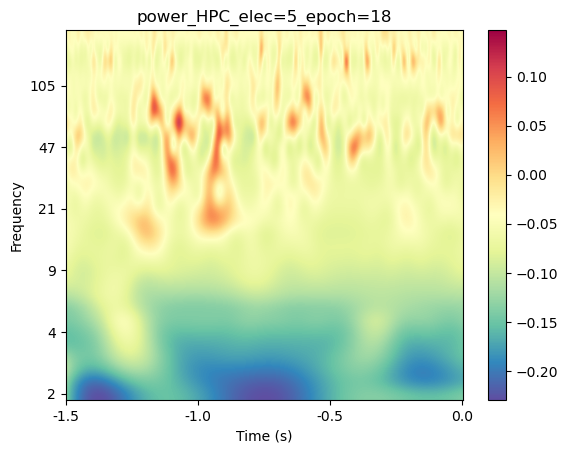

In [79]:
freqs = np.logspace(*np.log10([2, 200]), num=30)

for region in rois: 
    # if region == 'TC':
    #     region = (('Temporal') | ('Temporal Pole') | ('STS'))
    n_elecs = len(tfr_epoch_data[region][conditions[0]])
    for ch in range(n_elecs):
        for ix, cond in enumerate(conditions):
            # Set the times for 
            if tfr_epoch_data[region][cond] == []:
                continue
            n_epochs = tfr_epoch_data[region][cond][ch].shape[0]
            times = np.linspace(-1.5, 0, tfr_epoch_data[region][cond][ch].shape[2])
            plot_data = np.squeeze(np.stack(tfr_epoch_data[region][cond][ch]))

            for epoch in range(n_epochs):
                fig = plt.figure()#plt.subplots(1, 2, figsize=(20, 6), dpi=300)
                ax = plt.gca()

                im = ax.imshow(plot_data[epoch, :, :],
                                  aspect='auto', origin='lower', cmap='Spectral_r', interpolation = 'bicubic')            
                ax.set(xlabel='Time (s)', ylabel='Frequency', title=f'{cond}_{region}_elec={ch}_epoch={epoch}')
            
                # Set custom y-axis ticks and labels
                freq_res = 5
                time_res = 250 
                ax.set(yticks=np.arange(0, len(freqs))[::freq_res], 
                       yticklabels=freqs[::freq_res].astype(int), 
                       xticks = np.arange(len(times))[::time_res],
                       xticklabels= times[::time_res])#zpow.times[::time_res])
            
                fig.colorbar(im, ax=ax)
                plt.show()
        # plt.savefig(f'/sc/arion/work/qasims01/MemoryBanditData/EMU/plots/feedback_TFR_{cond_name}_{region}.pdf', dpi=300)
        

In [80]:
for cond in conditions:
    n_elecs = np.squeeze(np.stack(tfr_epoch_data[region][cond])).shape[0]
    for ch in range(n_elecs):
        n_epochs = np.squeeze(np.stack(tfr_epoch_data[region][cond][ch])).shape[0]
        for i in range(n_epochs):
            if np.any(np.isnan(tfr_epoch_data[region][cond][ch][i,:,:])):
                print(f'cond={cond}_elec={ch}_epoch{i}')

ValueError: all input arrays must have the same shape

In [58]:
n_elecs = np.squeeze(np.stack(tfr_epoch_data[region][conditions[0]])).shape[0]
n_elecs

6

In [271]:
power_epochs.freqs[14]

18.47341714374772

## Statistical Analyses of TFRs:

At this stage, you should **heavily** brainstorm the statistics you want to do, before you start writing any code. What is the goal of your analysis? What would actually allow you to show what you want to show?

Conduct the two-sample permutation test. This is most handy if your categories are naturally discrete, or helpful to bin. It is less good if you woud actually get statistical value from continuous stats.

In [154]:
# # freqs = np.logspace(*np.log10([4, 120]), num=30)

# # conditions = ['(rpe>0)',
# #              '(rpe<0)']
# # conditions = ['(rpe>0) & (hits==1)',
# #              '(rpe>0) & (hits==0)']

# cond_name = 'SME'
        
# # times = np.linspace(0, 1.5, np.stack(tfr_group_data[region][cond]).shape[2])
    
# for region in rois: 
#     # # Average the data in each condition across channels 
#     if 'SME' in cond_name:
#         X = [np.squeeze(np.vstack(tfr_group_data[region][conditions[0]])),
#              np.squeeze(np.vstack(tfr_group_data[region][conditions[1]]))]
#     else:
#         X = [np.stack(tfr_group_data[region][conditions[0]]), 
#              np.stack(tfr_group_data[region][conditions[1]])]
        
#     F_obs, clusters, cluster_p_values, H0 = \
# mne.stats.permutation_cluster_test(X, n_permutations=1000, out_type='mask', verbose=True,
#                                    threshold=6,
#                                    seed=1, n_jobs=1, tail=0)
    
#     # Create new stats image with only significant clusters
#     fig, ax = plt.subplots(1, 1, figsize=(6, 4), dpi=300)
    
#     # Average the data in each condition across epochs for plotting
#     evoked_power_1 = np.nanmean(X[0], axis=0)
#     evoked_power_2 = np.nanmean(X[1], axis=0)
#     evoked_power_contrast = evoked_power_1 - evoked_power_2
#     signs = np.sign(evoked_power_contrast)

#     F_obs_plot = np.nan * np.ones_like(F_obs)
#     for c, p_val in zip(clusters, cluster_p_values):
#         if p_val <= 0.05:
#             F_obs_plot[c] = F_obs[c] * signs[c]

#     ax.imshow(F_obs,
#               extent=[times[0], times[-1], freqs[0], freqs[-1]],
#               aspect='auto', origin='lower', cmap='Spectral_r', alpha =0.55)
#     max_F = np.nanmax(abs(F_obs_plot))
#     c= ax.imshow(F_obs_plot,
#               extent=[times[0], times[-1], freqs[0], freqs[-1]],
#               aspect='auto', origin='lower', cmap='Spectral_r',
#               vmin=-max_F, vmax=max_F)

#     ax.set(yticks=yticks, xlabel='Time (s)', ylabel='Frequency', title=f'{region}_{cond_name}')
#     fig.colorbar(c, ax=ax)
#     plt.savefig(f'/sc/arion/work/qasims01/MemoryBanditData/EMU/plots/feedback_clustperm_{cond_name}_{region}.pdf', dpi=300)


## One-sample cluster permutation test


A one sample cluster permutation test measures whether a spectrogram differs significantly from a particular mean (typically 0). 

  0%|          | Permuting : 0/499 [00:00<?,       ?it/s]

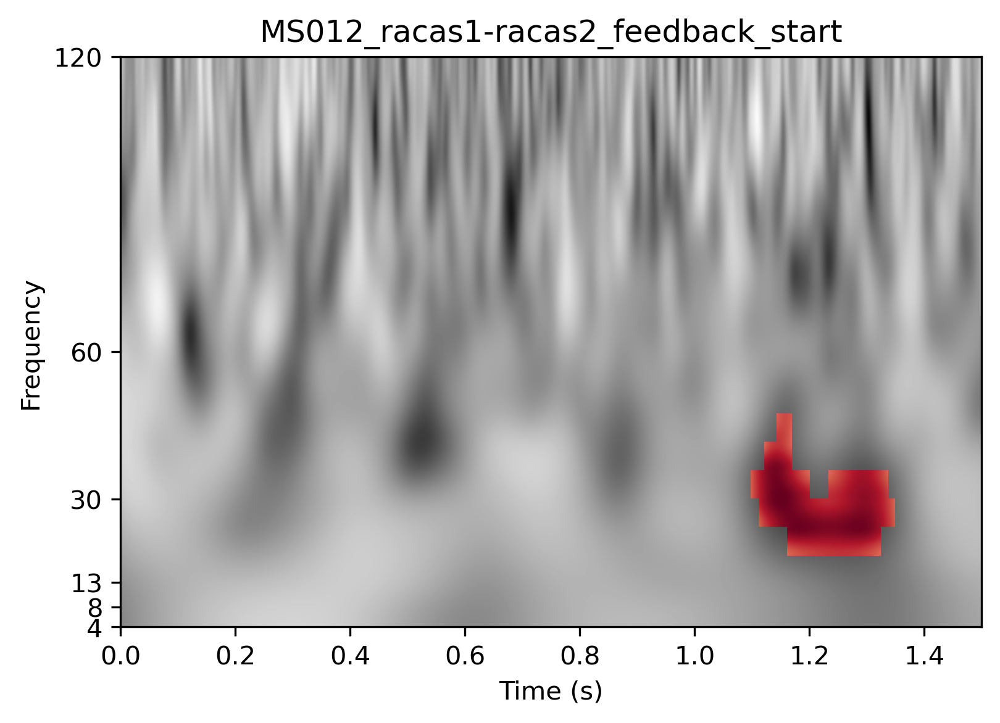

In [66]:
subj_id = 'MS012'
# region = 'frontal'

# save_path = f'{base_dir}/projects/guLab/Salman/EphysAnalyses/{subj_id}'
# # Get electrode df 
# elec_path = f'{base_dir}/projects/guLab/Salman/EMU/{subj_id}/anat/'
# # electrode files could either be csv or excel
# elec_files = glob(f'{elec_path}/*.csv') + glob(f'{elec_path}/*.xlsx')
# # There should really only be one 
# elec_file = elec_files[0]
# elec_data = lfp_preprocess_utils.load_elec(elec_file)

# anode_list = [x.split('-')[0] for x in epochs_all_subjs_all_evs[subj_id][event].ch_names]
# elec_df = elec_data[elec_data.label.str.lower().isin(anode_list)]
# # Shawn noticed the following would incorrectl y label electrodes if they're not in the same order as .ch_names! 
# # elec_df['label'] = epochs_all_subjs_all_evs[subj_id][event].ch_names
# # Fix: 
# elec_df['label'] = elec_df['label'].apply(lambda x: next((string for string in epochs_all_subjs_all_evs[subj_id][event].ch_names if x in string), np.nan))
    
# picks = analysis_utils.select_picks_rois(elec_df, region)

for event in analysis_evs:
    
    # Average the data in each condition across channels 
    X = np.nanmean(power_epochs[subj_id][event].copy().pick_channels([chan]).data, axis=1)
    
    F_obs, clusters, cluster_p_values, H0 = \
    mne.stats.permutation_cluster_1samp_test(X, n_permutations=500, out_type='mask', verbose=True)
    
    if any(cluster_p_values<=0.05):
#     print(region)
        # Create new stats image with only significant clusters
        fig, ax = plt.subplots(1, 1, figsize=(6, 4), dpi=300)

        times =  power_epochs[subj_id][event].times


        # Average the data in each condition across epochs for plotting
        evoked_power = np.nanmean(X, axis=0)
    #     evoked_power_2 = np.nanmean(X[1], axis=0)
    #     evoked_power_contrast = evoked_power_1 - evoked_power_2
        signs = np.sign(evoked_power)

        F_obs_plot = np.nan * np.ones_like(F_obs)
        for c, p_val in zip(clusters, cluster_p_values):
            if p_val <= 0.05:
                F_obs_plot[c] = F_obs[c] * signs[c]

        ax.imshow(F_obs,
                  extent=[times[0], times[-1], freqs[0], freqs[-1]], interpolation = 'Bicubic',
                  aspect='auto', origin='lower', cmap='gray')
        max_F = np.nanmax(abs(F_obs_plot))
        ax.imshow(F_obs_plot,
                  extent=[times[0], times[-1], freqs[0], freqs[-1]],
                  aspect='auto', origin='lower', cmap='RdBu_r',
                  vmin=-max_F, vmax=max_F)

        ax.set(yticks=yticks, xlabel='Time (s)', ylabel='Frequency', title=f'{subj_id}_{chan}_{event}')

            # # ax.set_title(f'Induced power ({ch_name})')
    
    

In [ ]:
x = np.